In [1]:
%matplotlib inline
%load_ext autoreload
%autoreload 2
import pandas as pd
import numpy as np
import sklearn.decomposition, sklearn.cluster
from nheatmap import nhm, scripts
import matplotlib.pyplot as plt
import matplotlib as mpl
import scanpy as sc

# create a color dictionary for tissues
def tissue_colors():
    
    tissue_color_dict = {'Bladder': '#e7969c',
             'Blood': '#d6616b',
             'Bone_Marrow': '#cedb9c',
             'Eye': '#c7ea46',#"#00ff7f",
             'Fat': '#e7cb94',
             'Heart': '#ff0800',
             'Kidney': '#7b4173',
             'Large_Intestine': '#31a354',
             'Liver': '#000080',
             'Lung': '#3182bd',
             'Lymph_Node': '#8c6d31',
             'Mammary':'#ce6dbd',
             'Muscle': '#e7ba52',
             'Pancreas': '#fd8d3c',
             'Prostate':'#637939',#'#a55194',#
             'Salivary_Gland':'#622a0f',
             'Skin': '#de9ed6',
             'Small_Intestine': '#6baed6',
             'Spleen': '#393b79',
             'Thymus': '#9c9ede',
             'Tongue':'#b5cf6b',
             'Trachea': '#969696',
             'Uterus':'#c64b8c',#'#ff0090',
             'Vasculature': '#843c39'}
    
    return tissue_color_dict

In [2]:
import matplotlib.pyplot as plt
import matplotlib as mpl

%matplotlib inline
params = {
    'font.size': 12,
    'axes.titlesize': 12,
    'axes.labelsize': 12,
    'legend.fontsize': 12,
    'xtick.labelsize': 12,
    'ytick.labelsize': 12,
    'font.family': "Helvetica",
    'pdf.fonttype': 42,
    'ps.fonttype': 42,
    'figure.dpi': 500
   }
mpl.rcParams.update(params)
SMALL_SIZE = 20
MEDIUM_SIZE = 22
BIGGER_SIZE = 24
plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

In [6]:

cell_type = 'macrophage'
remove_outlying_tissues = False

    
adata = sc.read_h5ad('../../data/TSP1_TSP15_scvi_donor-method_normalized-log1p-scaled_annotated.h5ad', backed='r+')                                                                                       
adata = adata[adata.obs.cell_ontology_class == cell_type]
if remove_outlying_tissues == True:
    adata = adata[~adata.obs.tissue.isin(['Salivary_Gland', 'Heart', 'Eye', 'Fat'])]

adata = adata.to_memory()

In [8]:
subset_genes = True

gene_set = pd.read_csv("macrophage_tissue_distinguishing_genes.csv", index_col=0)
dissociation_genes = pd.read_table('../../metadata/SuppTab5_GenesAffectedByDissociation.tsv') 
if subset_genes == True:
    adata = adata[:,adata.var.index.isin(gene_set.iloc[:,0])]

def _pp(adata, log, normalize, remove_dissociation, highly_variable):
    if remove_dissociation:
        adata.var['not_dissociation_gene'] = ~adata.var.index.isin(dissociation_genes['Gene_Symbol'])
        adata = adata[:, adata.var.not_dissociation_gene == True]
    if normalize:
        sc.pp.normalize_total(adata)
    if log:
        sc.pp.log1p(adata, chunk_size=50000)
        adata.raw = adata
    sc.pp.highly_variable_genes(adata, n_top_genes=600)

    if highly_variable:
        adata = adata[:,adata.var.highly_variable == True]

    return adata

adata = _pp(adata, True, True, False, False)

/home/michaelswift/miniconda3/envs/scirpy/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


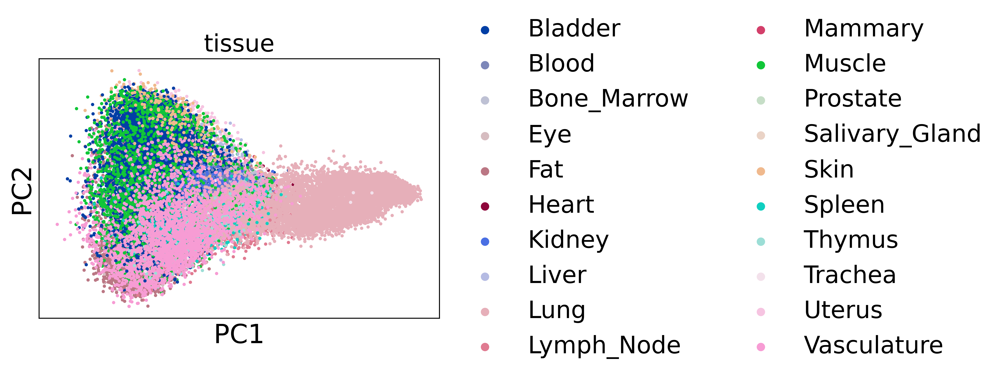

findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


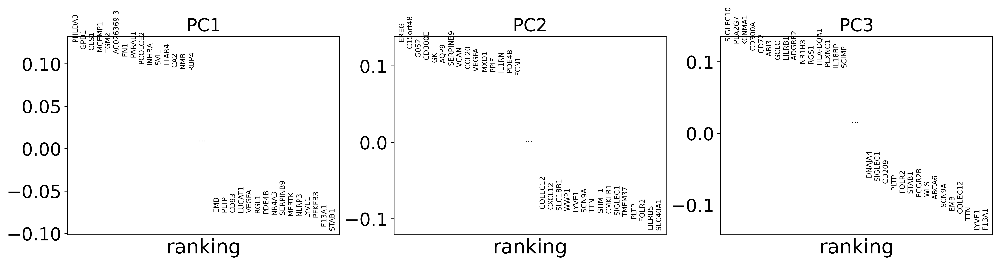

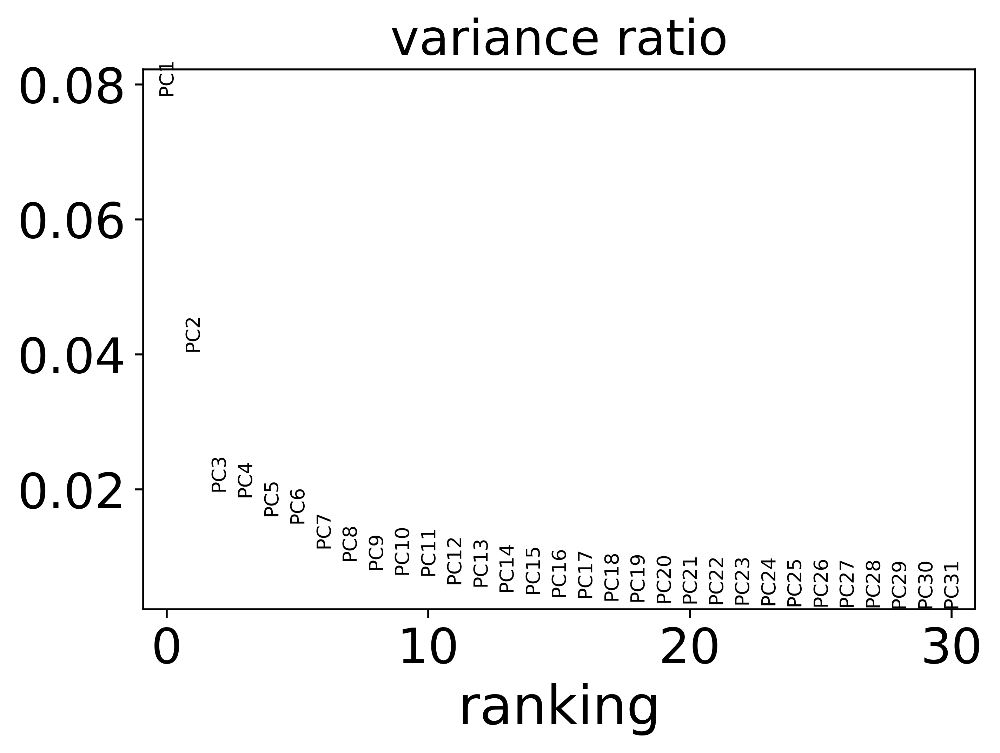

In [9]:
sc.pp.scale(adata, max_value=3)

sc.pp.pca(adata)

sc.pl.pca_overview(adata, color = ['tissue'], projection = '2d', size = 30)

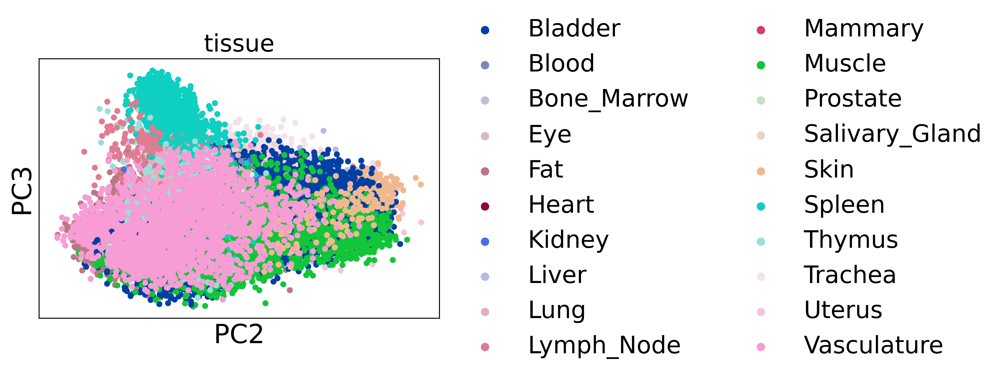

In [10]:
sc.pl.pca(adata, components=[2,3], color='tissue', size = 100, save="scatter_tissue_pca")

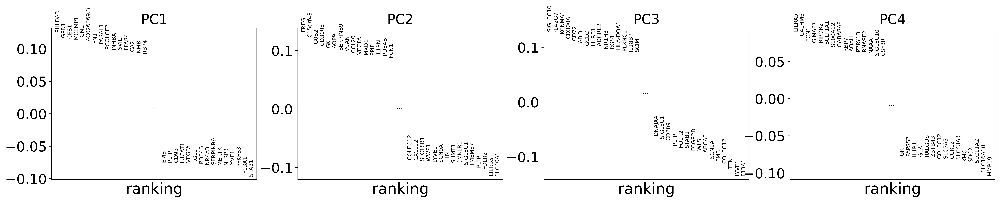

In [12]:
sc.pl.pca_loadings(adata, components=[1,2,3,4], save="_macrophage")

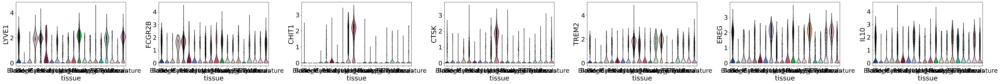

In [13]:
sc.pl.violin(adata, keys=['LYVE1','FCGR2B', 'CHIT1', 'CTSK', 'TREM2', 
                         'EREG', 'IL10'], groupby='tissue')

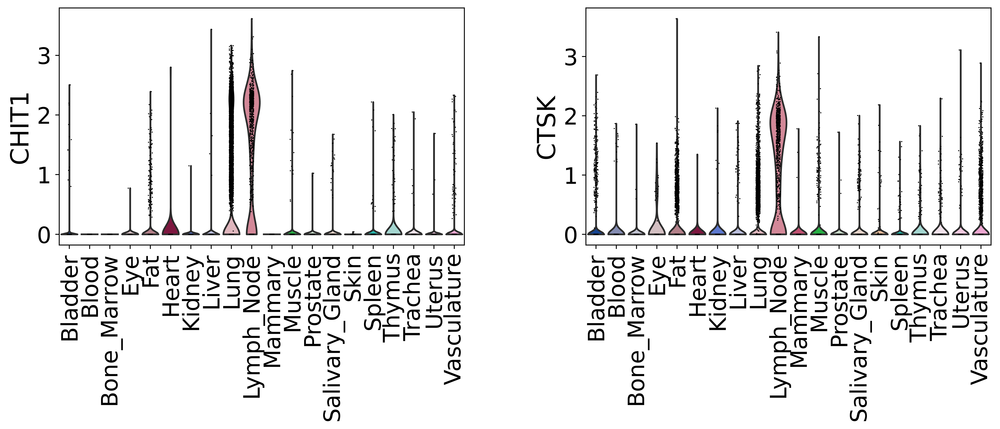

In [14]:
sc.pl.violin(adata, keys=['CHIT1', 'CTSK'], groupby='tissue', rotation=90)

Trying to set attribute `.uns` of view, copying.


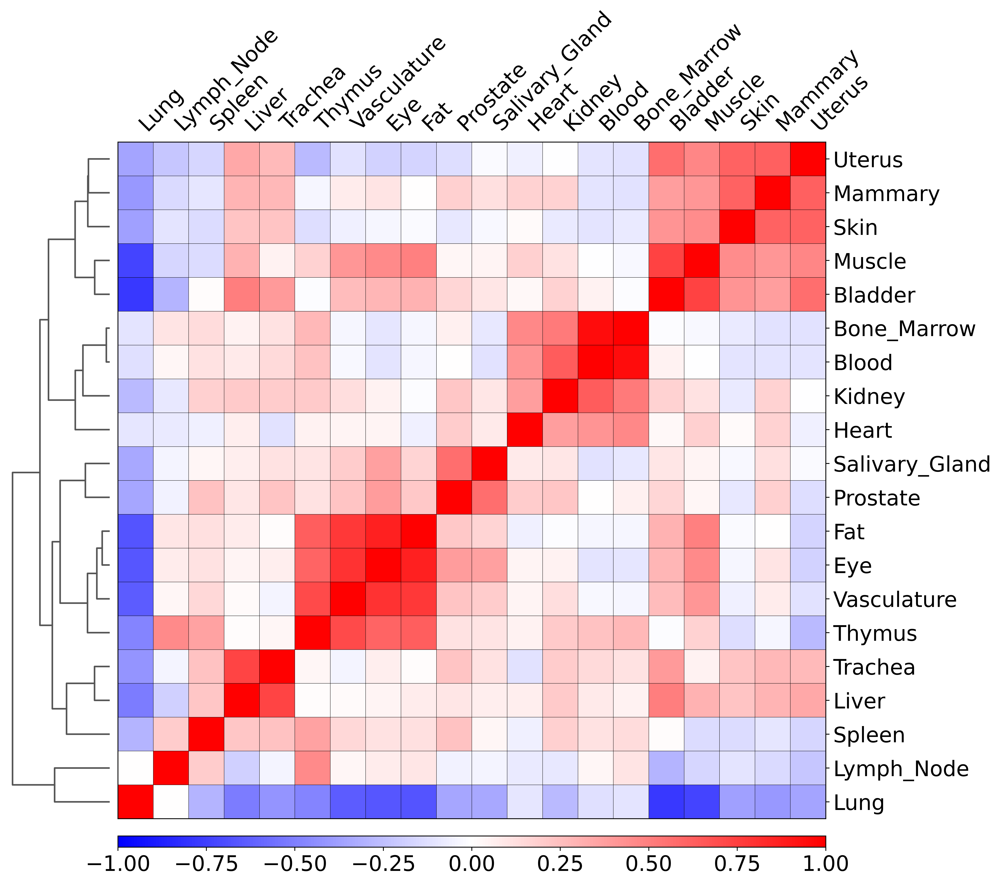

In [16]:
sc.pl.correlation_matrix(adata[:,adata.var.highly_variable == True], groupby='tissue')

Trying to set attribute `.uns` of view, copying.


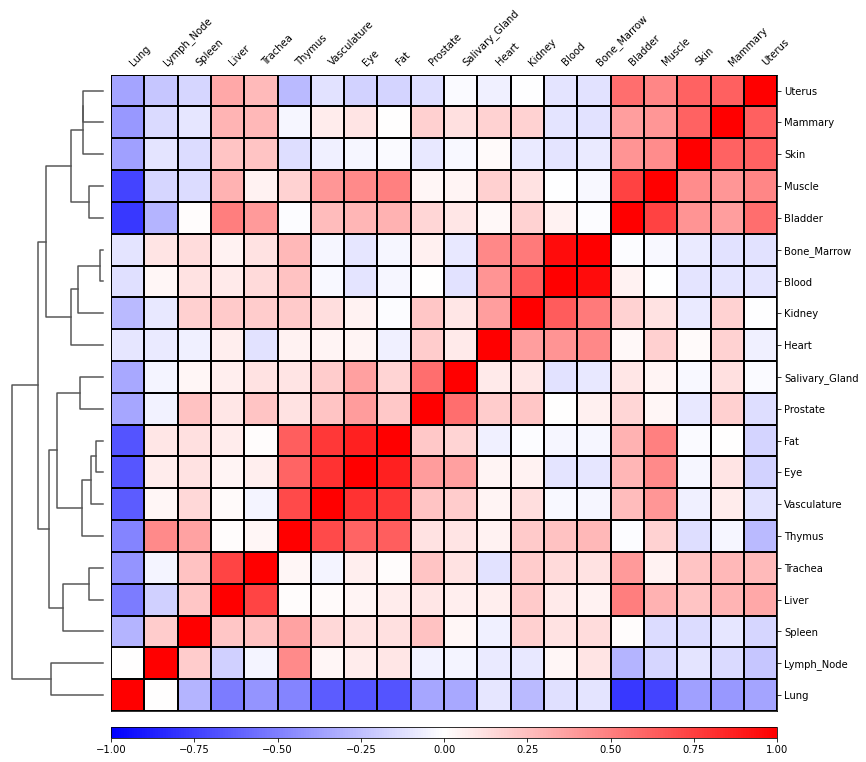

In [9]:
sc.pl.correlation_matrix(adata[:,adata.var.highly_variable == True], groupby='tissue', save='highly_variable_tissue_selected_genes_macrophage')

#### 

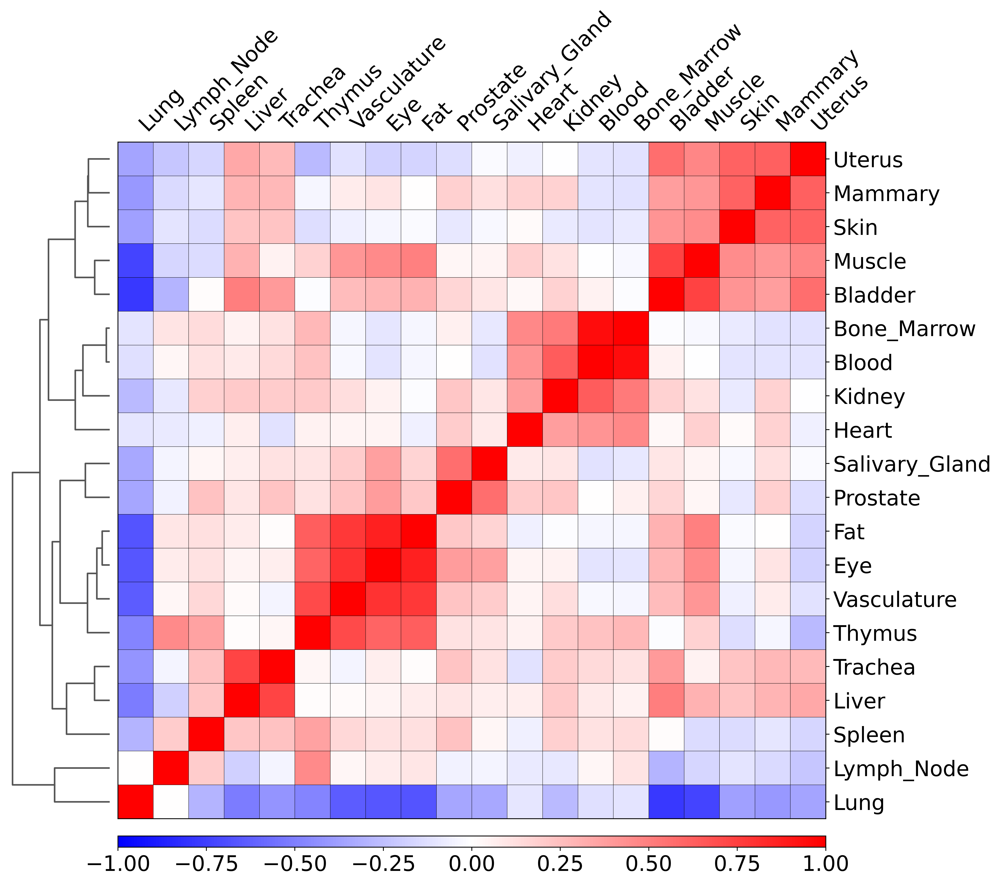

In [17]:
sc.pl.correlation_matrix(adata, groupby='tissue', save='tissue_selected_genes_macrophage')

## nheatmap

In [18]:
def convert_sparse_to_dataframe(adata):
    """ Input: anndata object with sparse matrix as .X attribute
        Returns: Pandas dataframe with rows as cells and columns as genes
        My take: Converting the data to a df inefficient but convenient and possibly more readable"""
    # Get the gene expression values for each cell x gene
    columns = adata.var.index.to_list()
    index = adata.obs.index.to_list()
    try:
        dense_array = adata.X.toarray()
    except:
        dense_array = adata.X
    df = pd.DataFrame(data=dense_array, index=index, columns=columns)
    return df

In [19]:
def make_nheatmap(adata_sub, cluster):

    dfr = sc.get.obs_df(
                    adata_sub,
                    keys=['tissue'])
    pc1 = adata_sub.obsm['X_pca'][:,0]
    pc2 = adata_sub.obsm['X_pca'][:,1]
    pc3 = adata_sub.obsm['X_pca'][:,2]

    dfr['PC1'], dfr["PC2"], dfr["PC3"] = pc1, pc2, pc3

    gene_PC1_score = adata_sub.varm['PCs'][:,0]
    gene_PC2_score = adata_sub.varm['PCs'][:,1]
    gene_PC3_score = adata_sub.varm['PCs'][:,2]

    df = convert_sparse_to_dataframe(adata_sub)

    dfc = sc.get.var_df(
                adata_sub)

    dfc["PC1_score"], dfc["PC2_score"], dfc["PC3_score"] = adata_sub.varm['PCs'][:,0], adata_sub.varm['PCs'][:,1], adata_sub.varm['PCs'][:,2]
    
    # color maps 
    # overdetermined dictionary results in no colormapping:
    tissue_color_dict = {your_key: tissue_colors()[your_key] for your_key in adata_sub.obs.tissue.unique() }

    cmaps={'PC1':'plasma', 'tissue':tissue_color_dict,
        'PC2':'gist_heat', 'PC3':'viridis', 'PC1_score':'inferno', 'PC2_score':'cividis', 'PC3_score':'magma' }
    g = nhm(data=df, dfr=dfr, dfc=dfc, figsize=(20, 20), showxticks=False, cmaps=cmaps)
    if cluster == True:
        g.hcluster()

    return g, dfr, dfc, df

In [20]:
def subset_adata(adata, hvg, fraction):
    adata_sub = adata.copy()
    sc.pp.subsample(adata_sub, fraction=fraction)
    adata_sub = adata_sub[:,adata_sub.var.highly_variable == hvg]
    return adata_sub

In [21]:
adata_sub = subset_adata(adata, True, 0.2)

In [22]:
g, dfr, dfc, df = make_nheatmap(adata_sub, False)

In [23]:
g, dfr, dfc, df = make_nheatmap(adata_sub, True)

In [24]:
fig, plots = g.run()


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


In [ ]:
fig.savefig('nheatmap_macrophage', format = "pdf")